# Evaluation ResNet34 FCN #
This notebook contains the evaluation of the ResNet34 FCN.    
Models trained by "Misc", "Tampere" and "Combined" Dataset are evaluated against the "Constance" Dataset.    
The "Constance" Dataset is given in two resolutions (960x640 and 576x384)

Imports:

In [1]:
import time
import os, sys
dir2 = os.path.abspath('')
dir1 = os.path.dirname(dir2)
if not dir1 in sys.path: sys.path.insert(0, dir1)


import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torchvision import transforms
from ummon import *

import torchvision.models as models
from models.resnet_34_fcn import ResNetFCN
from utils.water_segmentation import Water
from utils import metrics, dataset_statistics

from matplotlib import pyplot as plt
import numpy as np

# 1. Evaluation of model trained on "Tampere" only #
Load model:

In [2]:
# model
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
resnet34 = models.resnet34(pretrained=True)
model = ResNetFCN(resnet34, 1).to(device)

In [3]:
identifier = 'ResNet34_FCN_Tamp_RMS_lr_e-4'
directory = "../data/training_states/ResNet34_FCN"
state = "best_valid_loss.pth.tar"
path = os.path.join(directory,identifier + "_" + state)


# Load trained state in model
trs = Trainingstate()
trs.load_state_(path)
trs.load_weights_(model)
model = model.eval()

Prepare Test-Dataset:

In [4]:
# data loader 
# Get precalculated mean and standard deviation
mean, std = dataset_statistics.TAMP_OPEN_DOCK

# Transformation to normalize and unnormalize input images
norm = transforms.Normalize(mean, std)
inv_norm = transforms.Normalize(
   mean= [-m/s for m, s in zip(mean, std)],
   std= [1/s for s in std])

dataset_960_640 = Water('../data/WaterDataset', data_list_tamp=[], data_list_misc=[],
                    data_constance = True, transforms=norm, img_size=(960,640))

dataset_576_384 = Water('../data/WaterDataset', data_list_tamp=[], data_list_misc=[],
                    data_constance = True, transforms=norm, img_size=(576,384))

data_loader_960_640 = torch.utils.data.DataLoader(
        dataset_960_640, batch_size=1, shuffle=False, num_workers=4)

data_loader_576_384 = torch.utils.data.DataLoader(
        dataset_576_384, batch_size=1, shuffle=False, num_workers=4)

print(f'{len(dataset_960_640)} images in test dataset 960x640')
print(f'{len(dataset_576_384)} images in test dataset 576x384')

30 images in test dataset 960x640
30 images in test dataset 576x384


## Inference time: ##
### 960 x 640 ###

In [5]:
iterations = 100

# load 100 images in RAM
input_list = []
for i in range(iterations):
    input_list.append(dataset_960_640[i%20][0].unsqueeze(0))
# take time and start inference
t = time.perf_counter()
torch.cuda.synchronize() 
with torch.no_grad():
    for image in input_list:
        output=model(image.to(device))
        torch.cuda.synchronize() 
# calculate runtime
delta_t = time.perf_counter() - t
print("Time needed for single forward pass of 960x640 input :{:1.4f}".format(delta_t/iterations))

Time needed for single forward pass of 960x640 input :0.0134


### 576 x 384 ###

In [6]:
iterations = 100

#load 100 images in RAM
input_list = []
for i in range(iterations):
    input_list.append(dataset_576_384[i%20][0].unsqueeze(0))
t = time.perf_counter()
torch.cuda.synchronize() 
with torch.no_grad():
    for image in input_list:
        output=model(image.to(device))
        torch.cuda.synchronize() 
delta_t = time.perf_counter() - t
print("Time needed for single forward pass of 576x384 input :{:1.4f}".format(delta_t/iterations))

Time needed for single forward pass of 576x384 input :0.0060


## Performance on Test Set ("Constance"): ##
### 960 x 640 ###

In [7]:
from utils.segmentation_analyzer import SegmentationAnalyzer

loss = nn.BCEWithLogitsLoss()

ev = SegmentationAnalyzer.evaluate(model, loss, data_loader_960_640 )
print("Performance on test set: \nloss={:6.4f} \niou={:.4f} \nacc={:.4f} \nsensitivity={:.4f} \nspecificity={:.4f} \nprecision={:.4f} \nf1={:.4f}".format(
            ev["loss"], ev["iou"],ev["accuracy"], ev["sensitivity"], ev["specificity"], ev["precision"], ev["f1"]))

Performance on test set: 
loss=0.5202 
iou=0.7870 
acc=0.8713 
sensitivity=0.8815 
specificity=0.8429 
precision=0.8902 
f1=0.8745


### 576 x 384 ###

In [8]:
from utils.segmentation_analyzer import SegmentationAnalyzer

loss = nn.BCEWithLogitsLoss()

ev = SegmentationAnalyzer.evaluate(model, loss, data_loader_576_384)
print("Performance on test set: \nloss={:6.4f} \niou={:.4f} \nacc={:.4f} \nsensitivity={:.4f} \nspecificity={:.4f} \nprecision={:.4f} \nf1={:.4f}".format(
            ev["loss"], ev["iou"],ev["accuracy"], ev["sensitivity"], ev["specificity"], ev["precision"], ev["f1"]))

Performance on test set: 
loss=0.4154 
iou=0.8157 
acc=0.9037 
sensitivity=0.8368 
specificity=0.9675 
precision=0.9719 
f1=0.8924


## Predicted masks for Test Set: ##
### 960 x 640 ###

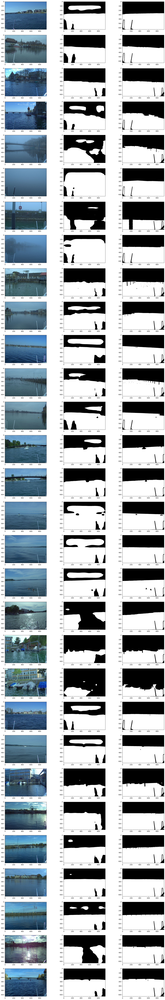

In [9]:
from utils.metrics import binarize

input_list = []
for i in range(30):
    input_list.append(dataset_960_640[i])
    
f, axs = plt.subplots(30,3,figsize=(20,120))

with torch.no_grad():
    j = 0
    for element in input_list:
        axs[j,0].imshow((np.transpose(inv_norm(element[0]),(1,2,0))*255).int())
        output=model(element[0].unsqueeze(0).to(device))
        output = binarize(torch.squeeze(output.data.cpu()), activation="sigmoid")
        axs[j,1].imshow(output, cmap='Greys_r')
        axs[j,2].imshow(element[1][0,:,:], cmap='Greys_r')
        j+=1   

### 576 x 384 ###

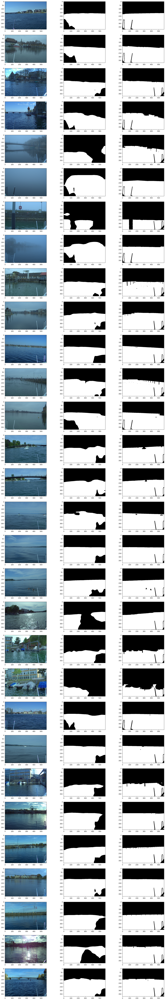

In [10]:
input_list = []
for i in range(30):
    input_list.append(dataset_576_384[i])
    
f, axs = plt.subplots(30,3,figsize=(20,120))

with torch.no_grad():
    j = 0
    for element in input_list:
        axs[j,0].imshow((np.transpose(inv_norm(element[0]),(1,2,0))*255).int())
        output=model(element[0].unsqueeze(0).to(device))
        output = binarize(torch.squeeze(output.data.cpu()), activation="sigmoid")
        axs[j,1].imshow(output, cmap='Greys_r')
        axs[j,2].imshow(element[1][0,:,:], cmap='Greys_r')
        j+=1   

# 2. Evaluation of model trained on "Misc" only #

Prepare Test-Dataset:

In [11]:
# data loader 
# Get precalculated mean and standard deviation
mean, std = dataset_statistics.MISC_TRAINING

# Transformation to normalize and unnormalize input images
norm = transforms.Normalize(mean, std)
inv_norm = transforms.Normalize(
   mean= [-m/s for m, s in zip(mean, std)],
   std= [1/s for s in std])

dataset_960_640 = Water('../data/WaterDataset', data_list_tamp=[], data_list_misc=[],
                    data_constance = True, transforms=norm, img_size=(960,640))

dataset_576_384 = Water('../data/WaterDataset', data_list_tamp=[], data_list_misc=[],
                    data_constance = True, transforms=norm, img_size=(576,384))

data_loader_960_640 = torch.utils.data.DataLoader(
        dataset_960_640, batch_size=1, shuffle=False, num_workers=4)

data_loader_576_384 = torch.utils.data.DataLoader(
        dataset_576_384, batch_size=1, shuffle=False, num_workers=4)

print(f'{len(dataset_960_640)} images in test dataset 960x640')
print(f'{len(dataset_576_384)} images in test dataset 576x384')

30 images in test dataset 960x640
30 images in test dataset 576x384


Load model:

In [12]:
identifier = 'ResNet34_FCN_Misc_RMS_lr_e-4'
directory = "../data/training_states/ResNet34_FCN"
state = "best_valid_loss.pth.tar"
path = os.path.join(directory,identifier + "_" + state)

# Load trained state in model
trs = Trainingstate()
trs.load_state_(path)
trs.load_weights_(model)
model = model.eval()

## Performance on Test Set ("Constance"): ##
### 960 x 640 ###

In [13]:
from utils.segmentation_analyzer import SegmentationAnalyzer

loss = nn.BCEWithLogitsLoss()

ev = SegmentationAnalyzer.evaluate(model, loss, data_loader_960_640 )
print("Performance on test set: \nloss={:6.4f} \niou={:.4f} \nacc={:.4f} \nsensitivity={:.4f} \nspecificity={:.4f} \nprecision={:.4f} \nf1={:.4f}".format(
            ev["loss"], ev["iou"],ev["accuracy"], ev["sensitivity"], ev["specificity"], ev["precision"], ev["f1"]))

Performance on test set: 
loss=0.0965 
iou=0.9283 
acc=0.9608 
sensitivity=0.9633 
specificity=0.9575 
precision=0.9606 
f1=0.9615


### 576 x 384 ###

In [14]:
from utils.segmentation_analyzer import SegmentationAnalyzer

loss = nn.BCEWithLogitsLoss()

ev = SegmentationAnalyzer.evaluate(model, loss, data_loader_576_384)
print("Performance on test set: \nloss={:6.4f} \niou={:.4f} \nacc={:.4f} \nsensitivity={:.4f} \nspecificity={:.4f} \nprecision={:.4f} \nf1={:.4f}".format(
            ev["loss"], ev["iou"],ev["accuracy"], ev["sensitivity"], ev["specificity"], ev["precision"], ev["f1"]))

Performance on test set: 
loss=0.0892 
iou=0.9395 
acc=0.9669 
sensitivity=0.9831 
specificity=0.9462 
precision=0.9540 
f1=0.9680


## Predicted masks for Test Set: ##

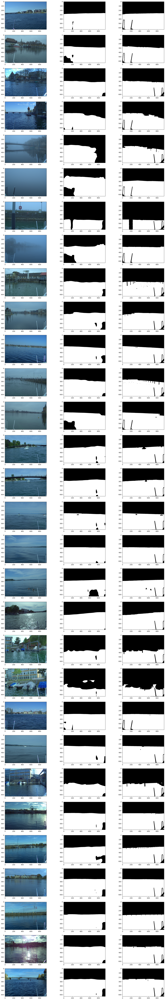

In [15]:
from utils.metrics import binarize

input_list = []
for i in range(30):
    input_list.append(dataset_960_640[i])
    
f, axs = plt.subplots(30,3,figsize=(20,120))

with torch.no_grad():
    j = 0
    for element in input_list:
        axs[j,0].imshow((np.transpose(inv_norm(element[0]),(1,2,0))*255).int())
        output=model(element[0].unsqueeze(0).to(device))
        output = binarize(torch.squeeze(output.data.cpu()), activation="sigmoid")
        axs[j,1].imshow(output, cmap='Greys_r')
        axs[j,2].imshow(element[1][0,:,:], cmap='Greys_r')
        j+=1  

In [16]:
state_dict = trs["model_state"]
torch.save(state_dict, directory+"/ResNet34_FCN_Misc")

# 3. Evaluation of model trained on "Misc" and "Tampere"

Prepare Test-Dataset:

In [17]:
# data loader 
# Get precalculated mean and standard deviation
mean, std = dataset_statistics.TAMP_OPEN_DOCK_MISC_TRN

# Transformation to normalize and unnormalize input images
norm = transforms.Normalize(mean, std)
inv_norm = transforms.Normalize(
   mean= [-m/s for m, s in zip(mean, std)],
   std= [1/s for s in std])

dataset_960_640 = Water('../data/WaterDataset', data_list_tamp=[], data_list_misc=[],
                    data_constance = True, transforms=norm, img_size=(960,640))

dataset_576_384 = Water('../data/WaterDataset', data_list_tamp=[], data_list_misc=[],
                    data_constance = True, transforms=norm, img_size=(576,384))

data_loader_960_640 = torch.utils.data.DataLoader(
        dataset_960_640, batch_size=1, shuffle=False, num_workers=4)

data_loader_576_384 = torch.utils.data.DataLoader(
        dataset_576_384, batch_size=1, shuffle=False, num_workers=4)

print(f'{len(dataset_960_640)} images in test dataset 960x640')
print(f'{len(dataset_576_384)} images in test dataset 576x384')

30 images in test dataset 960x640
30 images in test dataset 576x384


Load model:

In [18]:
identifier = 'ResNet34_FCN_Combined_RMS_lr_e-4'
directory = "../data/training_states/ResNet34_FCN"
state = "best_valid_loss.pth.tar"
path = os.path.join(directory,identifier + "_" + state)


# Load trained state in model
trs = Trainingstate()
trs.load_state_(path)
trs.load_weights_(model)
model = model.eval()

## Performance on Test Set ("Constance"): ##
### 960 x 640 ###

In [19]:
from utils.segmentation_analyzer import SegmentationAnalyzer

loss = nn.BCEWithLogitsLoss()

ev = SegmentationAnalyzer.evaluate(model, loss, data_loader_960_640 )
print("Performance on test set: \nloss={:6.4f} \niou={:.4f} \nacc={:.4f} \nsensitivity={:.4f} \nspecificity={:.4f} \nprecision={:.4f} \nf1={:.4f}".format(
            ev["loss"], ev["iou"],ev["accuracy"], ev["sensitivity"], ev["specificity"], ev["precision"], ev["f1"]))

Performance on test set: 
loss=0.0910 
iou=0.9273 
acc=0.9629 
sensitivity=0.9632 
specificity=0.9610 
precision=0.9608 
f1=0.9610


### 576 x 384 ###

In [20]:
from utils.segmentation_analyzer import SegmentationAnalyzer

loss = nn.BCEWithLogitsLoss()

ev = SegmentationAnalyzer.evaluate(model, loss, data_loader_576_384)
print("Performance on test set: \nloss={:6.4f} \niou={:.4f} \nacc={:.4f} \nsensitivity={:.4f} \nspecificity={:.4f} \nprecision={:.4f} \nf1={:.4f}".format(
            ev["loss"], ev["iou"],ev["accuracy"], ev["sensitivity"], ev["specificity"], ev["precision"], ev["f1"]))

Performance on test set: 
loss=0.0925 
iou=0.9298 
acc=0.9638 
sensitivity=0.9671 
specificity=0.9568 
precision=0.9607 
f1=0.9624


## Predicted masks for Test Set: ##

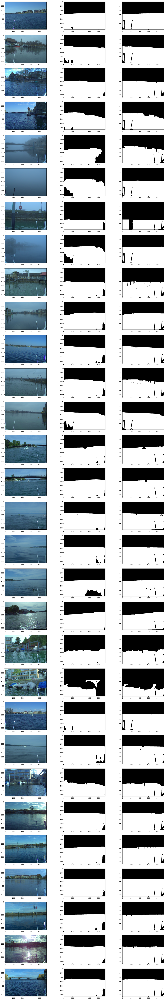

In [21]:
from utils.metrics import binarize

input_list = []
for i in range(30):
    input_list.append(dataset_960_640[i])
    
f, axs = plt.subplots(30,3,figsize=(20,120))

with torch.no_grad():
    j = 0
    for element in input_list:
        axs[j,0].imshow((np.transpose(inv_norm(element[0]),(1,2,0))*255).int())
        output=model(element[0].unsqueeze(0).to(device))
        output = binarize(torch.squeeze(output.data.cpu()), activation="sigmoid")
        axs[j,1].imshow(output, cmap='Greys_r')
        axs[j,2].imshow(element[1][0,:,:], cmap='Greys_r')
        j+=1  